In [ ]:
from google.colab.patches import cv2_imshow
import os, json, cv2, random

In [ ]:
!wget /content/sample_data/birds.jpg -q -o input.jpg

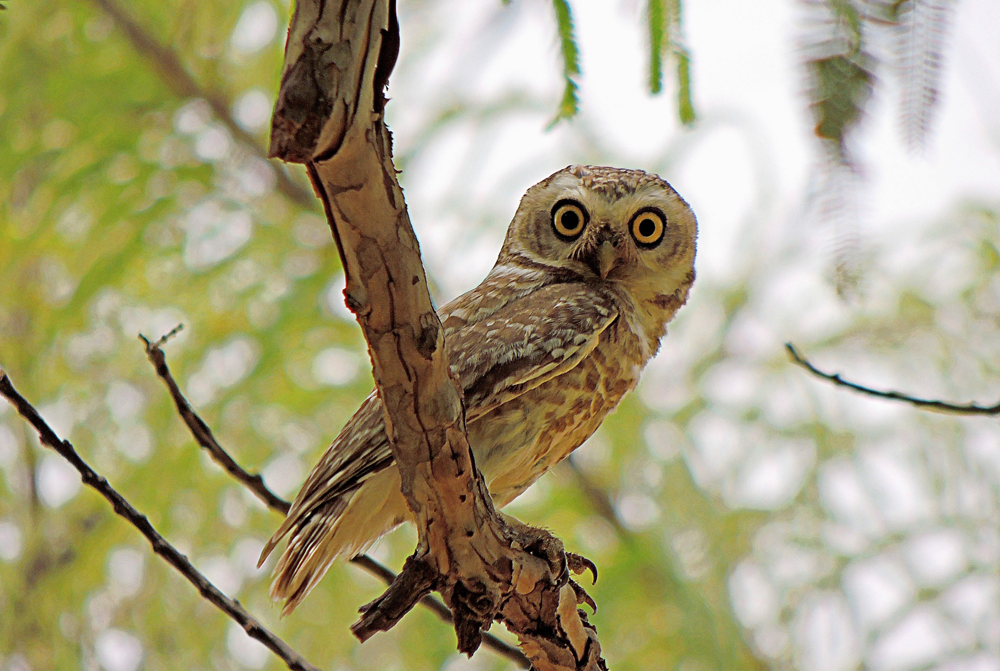

In [ ]:
im = cv2.imread('/content/sample_data/birds.jpg')
cv2_imshow(im)

In [8]:
im

array([[[ 26, 107,  92],
        [ 23, 104,  89],
        [ 48, 129, 114],
        ...,
        [245, 238, 243],
        [246, 239, 244],
        [247, 240, 245]],

       [[ 20, 103,  88],
        [  4,  87,  72],
        [ 12,  95,  80],
        ...,
        [246, 239, 244],
        [248, 241, 246],
        [250, 243, 248]],

       [[ 35, 121, 103],
        [ 33, 119, 101],
        [ 56, 142, 124],
        ...,
        [245, 238, 243],
        [246, 239, 244],
        [248, 241, 246]],

       ...,

       [[132, 149, 162],
        [131, 148, 161],
        [134, 152, 163],
        ...,
        [206, 206, 212],
        [203, 206, 211],
        [199, 202, 207]],

       [[129, 146, 159],
        [129, 146, 159],
        [132, 150, 161],
        ...,
        [205, 205, 211],
        [203, 206, 211],
        [198, 201, 206]],

       [[125, 142, 155],
        [124, 141, 154],
        [128, 146, 157],
        ...,
        [208, 208, 214],
        [208, 211, 216],
        [204, 207, 212]]

In [9]:
imarray = im.shape

In [10]:
print(imarray)

(3094, 4608, 3)


In [11]:
import matplotlib.pyplot as plt
import matplotlib.image as mping

%matplotlib inline

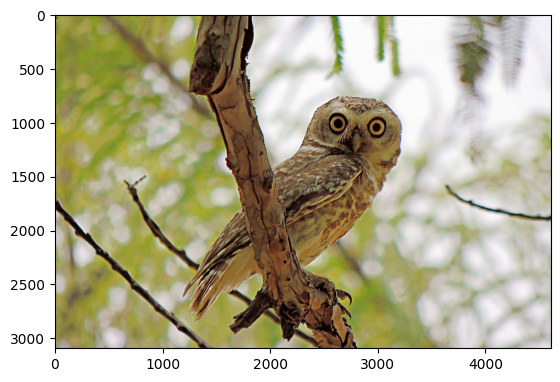

In [15]:
image = mping.imread('/content/sample_data/birds.jpg')

plt.imshow(image)

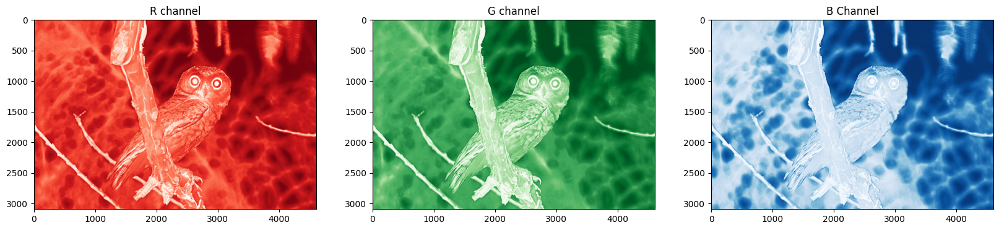

In [16]:
r = image[:,:,0]
g = image[:,:,1]
b = image[:,:,2]

f, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(20,10))
ax1.set_title("R channel")
ax1.imshow(r, cmap='Reds')
ax2.set_title("G channel")
ax2.imshow(g, cmap="Greens")
ax3.set_title("B Channel")
ax3.imshow(b, cmap='Blues')

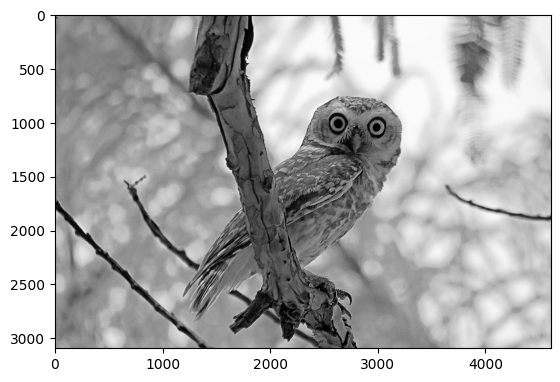

In [22]:
gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

plt.imshow(gray, cmap='gray')

In [23]:
from tensorflow.keras.datasets import mnist

In [25]:
(X_train, y_train),(X_test, y_test) = mnist.load_data()

print("The MNIST database has a training set of d% examples." %len(X_train))
print("The MNIST database has a test set of %d examples." %len(X_test))

11490434/11490434 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
The MNIST database has a training set of d 6.000000e+04xamples.
The MNIST database has a test set of 10000 examples.


2. Visualize the First Six

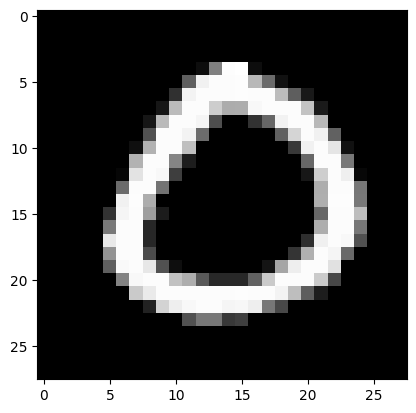

In [28]:
from ast import increment_lineno
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.cm as cm
import numpy as np
plt.imshow(X_train[58256], cmap='gray')

In [29]:
X_train.shape

(60000, 28, 28)

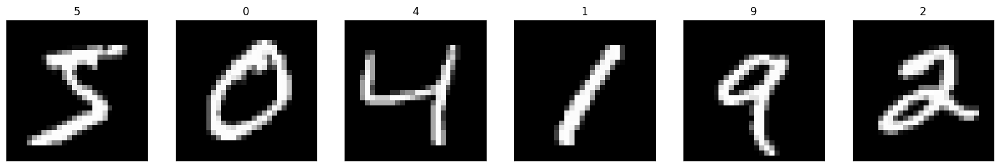

In [30]:
fig = plt.figure(figsize=(20,20))
for i in range(6):
  ax = fig.add_subplot(1, 6, i+1, xticks=[],yticks=[])
  ax.imshow(X_train[i], cmap='gray')
  ax.set_title(str(y_train[i]))

View an image in more detail


In [38]:
from tensorflow.keras.utils import to_categorical
num_classes = len(np.unique(y_train))

In [39]:
y_train = to_categorical(y_train, num_classes)
y_test = to_categorical(y_test, num_classes)
print('One hot valued lables')
print(y_train.shape)

One hot valued lables
(60000, 10)


In [40]:
img_rows, img_cols = 28,28

X_train = X_train.reshape(X_train.shape[0], 28, 28, 1)
X_test = X_test.reshape(10000, 28, 28, 1)
print('X_train shape:', X_train.shape)
print('X_test shape:', X_test.shape)

X_train shape: (60000, 28, 28, 1)
X_test shape: (10000, 28, 28, 1)


In [41]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout

In [43]:
model = Sequential()

model.add(Conv2D(32, kernel_size=(3,3), padding='same', activation='relu',input_shape=(28,28,1)))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Conv2D(64,(3,3),padding='same', activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dense(num_classes, activation='softmax'))
model.summary()

/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 28, 28, 32)     │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 14, 14, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 14, 14, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 7, 7, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 3136)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │       200,768 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 10)             │           650 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 220,234 (860.29 KB)

 Trainable params: 220,234 (860.29 KB)

 Non-trainable params: 0 (0.00 B)

In [44]:
model.compile(loss='categorical_crossentropy', optimizer='rmsprop',
              metrics=['accuracy'])

In [ ]:
from re import VERBOSE
from tensorflow.keras.callbacks import ModelCheckpoint
checkpointer = ModelCheckpoint(filepath = 'model.weights.best.keras', verbose=1, save_best_only=True)
hist = model.fit(X_train, y_train, batch_size=64, epochs=2, validation_data=(X_test, y_test), callbacks=[checkpointer],
                 verbose=2, shuffle=True)

Epoch 1/2
